In [21]:
using Plots
using LinearAlgebra
using DifferentialEquations

# Define the nullcline functions
function nullcline_a(x, p, b, c)
    return (p + b - (2 * x) / ((x^2 + 1)^2)) / (2 * c * x)
end

function nullcline_x(b, x)
    return b * x - (x^2) / (x^2 + 1)
end

# Define the Jacobian matrix
function jacobian_bound(x, a, b, c, p)
    df_dx = -b + (2 * x) / ((x^2 + 1)^2)
    df_dl = 1
    dg_dx = 2 * c * a^2 + a * ((2 - 6 * x^2) / (x^2 + 1)^3)
    dg_dl = 4 * c * x * a - p - b * (2 * x) / (x^2 + 1)^2

    return [df_dx df_dl; dg_dx dg_dl]
end


function jacobian_int(x, a, b, c, p)
    l = -1/a
    df_dx = -b + (2 * x) / ((x^2 + 1)^2)
    df_dl = 1 / (l^2)
    dg_dx =2 * c - ((2 * l) * (1 - 3 * x^2)) / ((x^2 + 1)^3) 
    dg_dl = p + b - (2 * x) / ((x^2 + 1)^2)
    return [df_dx df_dl; dg_dx dg_dl]
end



# Define the state and costate equations
function state_eq(a, b, x)
    
    a - b * x + (x^2) / (x^2 + 1)
end

function costate_eq(a, b, c, p, x)
    l = -1/a

    2*c*x*a^2 - a*  (p + b - (2*x)/(x^2 +1)^2)
end

# Define the system of ODEs
function system!(du, u, p, t)
    a, x = u
    b, c, p_val = p
    du[1] = state_eq(a, b, x)
    du[2] = costate_eq(a, b, c, p_val, x)
    
end

# Parameters
b = 0.65
p = 0.03
c = 0.5
x = range(0.01, 2, length=300)

# Compute nullclines
f2 = nullcline_a.(x, p, b, c)
f1 = nullcline_x.(b, x)

# Saddle points
ss1_x = 0.45301029168136897
ss1_a = 0.1241818769554022

ss2_x = 0.8734185245691611
ss2_a =  0.1349820876632285

ss3_x = 1.436961466047747
ss3_a = 0.2603043162259756

(0.45301029168136897, 0.1241818769554022)
(0.8734185245691611, 0.1349820876632285)
(1.436961466047747, 0.2603043162259756)



saddles_bound = [(ss1_x, ss1_a), (ss3_x, ss3_a)]
saddles_int= [(ss2_x, ss2_a)]
# Plot the stable manifold


1-element Vector{Tuple{Float64, Float64}}:
 (0.8734185245691611, 0.1349820876632285)

(0.45301029168136897, 0.1241818769554022)
Eigenvalues: [-0.47782334852602615, 0.128645201222849]
Eigenvectors: [-0.9113860593232929 0.9882145291582858; 0.41155248859794236 0.15307528984283347]
Stable eigenvalue = [-0.47782334852602615]


┌ Warning: At t=-4.185766162740552, dt was forced below floating point epsilon 8.881784197001252e-16, and step error estimate = 8.123786762755618. Aborting. There is either an error in your model specification or the true solution is unstable (or the true solution can not be represented in the precision of Float64).
└ @ SciMLBase C:\Users\imaan\.julia\packages\SciMLBase\YTOjh\src\integrator_interface.jl:623


(1.436961466047747, 0.2603043162259756)
Eigenvalues: [-0.31257673368967975, 0.4877547322630263]
Eigenvectors: [-0.9995051701409113 -0.7687999584387099; -0.0314549656109848 -0.6394893462010434]
Stable eigenvalue = [-0.31257673368967975]


┌ Warning: At t=-3.527786050228658, dt was forced below floating point epsilon 4.440892098500626e-16, and step error estimate = 8.123778553162003. Aborting. There is either an error in your model specification or the true solution is unstable (or the true solution can not be represented in the precision of Float64).
└ @ SciMLBase C:\Users\imaan\.julia\packages\SciMLBase\YTOjh\src\integrator_interface.jl:623
┌ Warning: At t=-3.7267434810779507, dt was forced below floating point epsilon 4.440892098500626e-16, and step error estimate = 8.12378351011712. Aborting. There is either an error in your model specification or the true solution is unstable (or the true solution can not be represented in the precision of Float64).
└ @ SciMLBase C:\Users\imaan\.julia\packages\SciMLBase\YTOjh\src\integrator_interface.jl:623
┌ Warning: At t=-1.779435585915597, dt was forced below floating point epsilon 2.220446049250313e-16, and step error estimate = 8.1237852327997. Aborting. There is either an erro

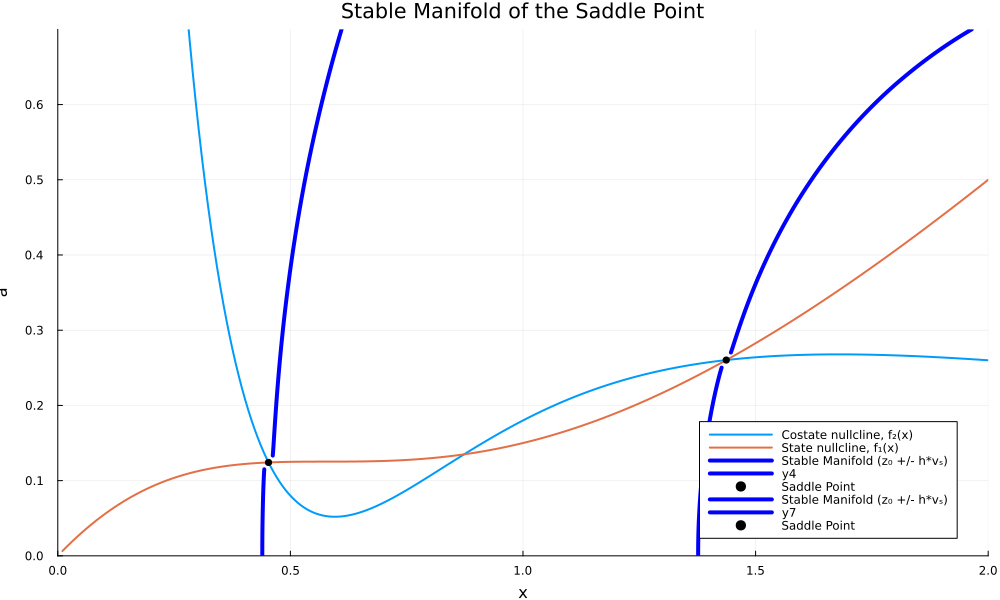

In [22]:
plot(x, f2, label="Costate nullcline, f₂(x)", lw=2, size=(1000, 600))
plot!(x, f1, label="State nullcline, f₁(x)", lw=2)
stable_manifolds_minus = []

for saddle in saddles_bound
    print(saddle, "\n")
    print()
    Jac = jacobian_bound(saddle[1], saddle[2], b, c, p)

    # Calculate eigenvalues and eigenvectors
    values, vectors = eigen(Jac)
    println("Eigenvalues: ", values)
    println("Eigenvectors: ", vectors)

    # Stable eigenvector (corresponding to the negative eigenvalue)
    stable_idx = findall(x -> real(x) < 0, values)
    println("Stable eigenvalue = ", values[stable_idx])
    stable_eigenvector = vectors[:, stable_idx]
    stable_eigenvector /= norm(stable_eigenvector)  # Normalize to unit length

    # Perturb the saddle point along the stable eigenvector
    h = 0.01
    z0_plus = [saddle[2] + h * stable_eigenvector[1], saddle[1] + h * stable_eigenvector[1]]
    z0_minus = [saddle[2] - h * stable_eigenvector[1], saddle[1] - h * stable_eigenvector[1]]
    # Integrate backwards in time
    t_span = (-10, 0)
    t_eval = range(-10, 0, length=400000)
    prob_plus = ODEProblem(system!, z0_plus, t_span, (b, c, p))
    prob_minus = ODEProblem(system!, z0_minus, t_span, (b, c, p))
    sol_plus = solve(prob_plus, Rodas5(), saveat=t_eval, maxiters=1_000_000)
    sol_minus = solve(prob_minus, Rodas5(), saveat=t_eval, maxiters=1_000_000)
    push!(stable_manifolds_minus, sol_minus)
    # Plot the stable manifolds
    plot!(sol_plus[2, :], sol_plus[1, :], label="Stable Manifold (z₀ +/- h*vₛ)", color=:blue, lw = 4)
    plot!(sol_minus[2, :], sol_minus[1, :], color=:blue, lw = 4)
    scatter!([saddle[1]], [saddle[2]], label="Saddle Point", color=:black, markersize=4)
end

xlabel!("x")
ylabel!("a")
title!("Stable Manifold of the Saddle Point")
xlims!(0, 2)
ylims!(0, .7)
plot!(grid = true)


In [3]:
saddles_int= [(ss2_x, ss2_a)]


stable_manifolds_minus = []
stable_manifolds_plus = []

for saddle_int in saddles_int
    print(saddle_int)
    J_int = jacobian_int(saddle_int[1], saddle_int[2], b, c, p)

    # Calculate eigenvalues and eigenvectors
    values, vectors = eigen(J_int)
    values = real(values)
    vectors = real(vectors)
    println("Eigenvalues: ", values)
    println("Eigenvectors: ", vectors)

    # Stable eigenvector (corresponding to the negative eigenvalue)
    stable_idx = argmin(abs.(values))
    println("Stable eigenvalue = ", values[stable_idx])
    stable_eigenvector = vectors[:, stable_idx]
    stable_eigenvector /= norm(stable_eigenvector)  # Normalize to unit length

    # Perturb the saddle point along the stable eigenvector
    h = 0.01
    z0_plus = [saddle_int[2] + h * stable_eigenvector[1], saddle_int[1]]
    z0_minus = [saddle_int[2] - h * stable_eigenvector[1], saddle_int[1]]

    # Integrate backwards in time
    t_span = (-10, 0)
    t_eval = range(-10, 0, length=4000)
    prob_plus = ODEProblem(system!, z0_plus, t_span, (b, c, p))
    prob_minus = ODEProblem(system!, z0_minus, t_span, (b, c, p))
    sol_plus = solve(prob_plus, Rodas5(), saveat=t_eval, maxiters=1_000_000)
    sol_minus = solve(prob_minus, Rodas5(), saveat=t_eval, maxiters=1_000_000)

    push!(stable_manifolds_minus, sol_minus)
    push!(stable_manifolds_plus, sol_plus)


    # Plot the stable manifolds
    plot!(sol_plus[2, :], sol_plus[1, :], label="Stable Manifold (z₀ +/- h*vₛ)", color=:red,  lw = 4)
    plot!(sol_minus[2, :], sol_minus[1, :], color=:red, lw = 4)
    scatter!([saddle_int[1]], [saddle_int[2]], label="Saddle Point", color=:black, markersize=4)
end




xlabel!("x")
ylabel!("a")
title!("Stable Manifolds of the steady states")
xlims!(0, 2)
ylims!(0, .7)
plot!(grid = true)
plot!(legendfontsize=10)
savefig("stable_manifolds.png")

(0.8734185245691611, 0.1349820876632285)

Eigenvalues: [0.015000000000000022, 0.015000000000000022]
Eigenvectors: [-0.04125462412586848 -0.04125462412586848; -0.9963541132745298 -0.9963541132745298]
Stable eigenvalue = 0.015000000000000022


"c:\\Users\\imaan\\OneDrive\\Documenten\\CS UVA\\CED 2\\A3_3\\CED2_A3\\stable_manifolds.png"

In [4]:
saddles_int= [(ss2_x, ss2_a)]

# Initialize lists to store a and x values
a_values_minus_int = []
x_values_minus_int = []
a_values_plus_int = []
x_values_plus_int = []

stable_manifolds_minus_a = []
stable_manifolds_plus_a = []
plot(x, f2, label="Costate nullcline, f₂(x)", lw=2, size=(1000, 600))
plot!(x, f1, label="State nullcline, f₁(x)", lw=2)
for saddle_int in saddles_int
    print(saddle_int)
    J_pure = jacobian_int(saddle_int[1], saddle_int[2], b, c, p)

    # Calculate eigenvalues and eigenvectors
    values, vectors = eigen(J_pure)
    values = real(values)
    vectors = real(vectors)
    println("Eigenvalues: ", values)
    println("Eigenvectors: ", vectors)

    # Stable eigenvector (corresponding to the negative eigenvalue)
    stable_idx = argmin(abs.(values))
    println("Stable eigenvalue = ", values[stable_idx])
    stable_eigenvector = vectors[:, stable_idx]
    stable_eigenvector /= norm(stable_eigenvector)  # Normalize to unit length

    # Perturb the saddle point along the stable eigenvector
    h = 0.01
    z0_plus = [saddle_int[2] + h * stable_eigenvector[1], saddle_int[1]]
    z0_minus = [saddle_int[2] - h * stable_eigenvector[1], saddle_int[1]]

    # Integrate backwards in time
    t_span = (-10, 0)
    t_eval = range(-10, 0, length=4000)
    prob_plus = ODEProblem(system!, z0_plus, t_span, (b, c, p))
    prob_minus = ODEProblem(system!, z0_minus, t_span, (b, c, p))
    sol_plus = solve(prob_plus, Rodas5(), saveat=t_eval, maxiters=1_000_000)
    sol_minus = solve(prob_minus, Rodas5(), saveat=t_eval, maxiters=1_000_000)

    # Save a and x values from sol_minus
    append!(a_values_minus_int, sol_minus[1, :])  # a values
    append!(x_values_minus_int, sol_minus[2, :])  # x values

    # Save a and x values from sol_plus
    append!(a_values_plus_int, sol_plus[1, :])  # a values
    append!(x_values_plus_int, sol_plus[2, :])  # x values


    # Plot the stable manifolds
    plot!(sol_plus[2, :], sol_plus[1, :], label="Stable Manifold (z₀ + h*vₛ)", color=:green,  lw = 4)
    plot!(sol_minus[2, :], sol_minus[1, :], label="Stable Manifold (z₀ - h*vₛ)", color=:orange, lw = 4)
    scatter!([saddle_int[1]], [saddle_int[2]], label="Saddle Point", color=:black, markersize=4)
end


xlabel!("x")
ylabel!("a")
title!("Stable Manifold of the Saddle Point")
xlims!(0, 2)
ylims!(0, .6)
plot!(grid = true)


a_values_plus_reversed_int = reverse!(a_values_plus_int)  # Access the last element of stable_manifolds_plus
x_values_plus_reversed_int = reverse!(x_values_plus_int)  # Access the last element of stable_manifolds_plus


(0.8734185245691611, 0.1349820876632285)Eigenvalues: [0.015000000000000022, 0.015000000000000022]
Eigenvectors: [-0.04125462412586848 -0.04125462412586848; -0.9963541132745298 -0.9963541132745298]
Stable eigenvalue = 0.015000000000000022


4000-element Vector{Any}:
 -71.26119652392255
 -71.08321244271016
 -70.90567279678037
 -70.72857648108875
 -70.55192239307051
 -70.37570943264035
 -70.19993650219261
 -70.0246025066012
 -69.8497063532196
 -69.67524695188085
 -69.5012232148976
 -69.32763405706208
 -69.1544783956461
   ⋮
   0.8733461466857882
   0.8733526075825209
   0.8733590917802335
   0.8733655994380611
   0.873372130715769
   0.8733786857737537
   0.8733852647730421
   0.8733918678752928
   0.8733984952427946
   0.8734051470384675
   0.8734118234258625
   0.8734185245691611

In [5]:
print( "A", a_values_plus_int)


AAny[174.97127550756835, 174.41625166171474, 173.8629022869105, 173.31122250891735, 172.76120746588526, 172.2128523083523, 171.66615219924475, 171.12110231387706, 170.5776978399519, 170.0359339775601, 169.4958059391806, 168.9573089496806, 168.4204382463154, 167.88518907872856, 167.35155670895176, 166.8195364114049, 166.289123472896, 165.76031319262125, 165.23310088216516, 164.70748186550023, 164.18345147898722, 163.66100507137506, 163.1401380038009, 162.62084564979, 162.1031233952558, 161.5869666385, 161.07237079021235, 160.5593312734709, 160.04784352374176, 159.53790298887932, 159.0295051291261, 158.52264541711278, 158.01731933785825, 157.51352238876956, 157.01125007964194, 156.51049793265878, 156.0112614823917, 155.51353627580042, 155.0173178722329, 154.52260184342526, 154.02938377350176, 153.53765925897488, 153.04742390874526, 152.55867334410175, 152.0714031987213, 151.5856091186691, 151.10128676239853, 150.61843180075107, 150.13703991695644, 149.65710680663253, 149.17862817778538, 

In [6]:
print("X", x_values_plus_int)

XAny[-71.26119652392255, -71.08321244271016, -70.90567279678037, -70.72857648108875, -70.55192239307051, -70.37570943264035, -70.19993650219261, -70.0246025066012, -69.8497063532196, -69.67524695188085, -69.5012232148976, -69.32763405706208, -69.1544783956461, -68.98175515040099, -68.80946324355772, -68.63760159982684, -68.46616914639843, -68.29516481294222, -68.12458753160746, -67.95443623702299, -67.78470986629723, -67.61540735901822, -67.44652765725351, -67.27806970555028, -67.11003245093526, -66.94241484291479, -66.77521583347473, -66.60843437708058, -66.4420694306774, -66.27611995368984, -66.11058490802209, -65.94546325805794, -65.78075397066077, -65.61645601517354, -65.45256836341876, -65.28908998969854, -65.12601987079458, -64.96335698596813, -64.80110031696005, -64.63924884799074, -64.47780156576023, -64.31675745944807, -64.15611552071344, -63.99587474369507, -63.836034125011274, -63.67659266375994, -63.51754936151856, -63.358903222344175, -63.20065325277342, -63.0427984618225,

In [7]:
print(a_values_minus_int)

Any[0.13539578902760746, 0.1353968240752292, 0.1353978602550556, 0.13539889757497825, 0.13539993604288134, 0.1354009756666418, 0.13540201645412897, 0.1354030584132049, 0.13540410155172433, 0.1354051458775344, 0.135406191398475, 0.13540723812237865, 0.13540828605707034, 0.13540933521036777, 0.13541038559008126, 0.1354114372040136, 0.1354124900599604, 0.13541354416570967, 0.13541459952904214, 0.13541565615773113, 0.13541671405954253, 0.1354177732422349, 0.13541883371355928, 0.1354198954812595, 0.13542095855307185, 0.13542202293672526, 0.1354230886399413, 0.1354241556704341, 0.1354252240359104, 0.13542629374406964, 0.13542736480260373, 0.13542843721919726, 0.13542951100152742, 0.13543058615726397, 0.13543166269406934, 0.13543274061959848, 0.13543381994149906, 0.1354349006674112, 0.13543598280496777, 0.13543706636179423, 0.13543815134550852, 0.13543923776372133, 0.13544032562403588, 0.135441414934048, 0.13544250570134614, 0.13544359793351135, 0.13544469163811731, 0.1354457868227303, 0.1354

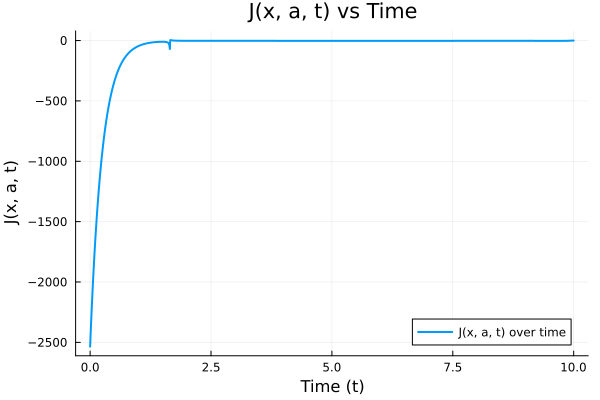

In [8]:
# Function to compute J(x, a, t)
function J(x, a, t, c, p)
    return (log(a) - c * x^2) -1 + (b*x)/a - (x^2)/((x^2+1)*a)
end

tim = range(0, 10, length=length(a_values_plus_reversed_int) + length(a_values_minus_int))

a_concat  = vcat(a_values_plus_reversed_int, a_values_minus_int)
x_concat = vcat(x_values_plus_reversed_int, x_values_minus_int)


sols = []
for i in 1:length(a_concat)
    x = x_concat[i]
    a = a_concat[i]
    t = tim[i]
    soln = J(x,a,t,c,p)
    append!(sols, soln)  # x values

end


plot(tim, sols, label="J(x, a, t) over time", lw=2)
xlabel!("Time (t)")
ylabel!("J(x, a, t)")
title!("J(x, a, t) vs Time")
plot!(grid = true)




Integral of J(x, a, t) over time using QuadGK: -50729.93508200608


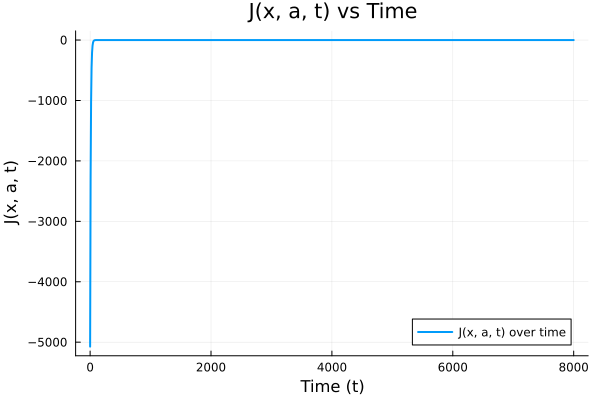

In [9]:
using QuadGK, Plots

# Function to compute J(x, a, t)
function J(x, a, t, c, p)
    return (log(a) - c * x^2) * exp(-p * t)
end

# Define constants
a0 = 174.9712755075683
x0 = -71.2611965239225
c = 1.0  # Example value for c
p = 0.1  # Example value for p

# Define time range
tim = range(0, 8000, length=1000)  

# Compute J(x, a, t) over the time range
J_values = [J(x0, a0, t, c, p) for t in tim]

# Perform numerical integration using `quadgk`
integral_result, _ = quadgk(t -> J(x0, a0, t, c, p), 0, 8000)

# Print result
println("Integral of J(x, a, t) over time using QuadGK: ", integral_result)

# Plot J(x, a, t) over time
plot(tim, J_values, label="J(x, a, t) over time", lw=2)
xlabel!("Time (t)")
ylabel!("J(x, a, t)")
title!("J(x, a, t) vs Time")
plot!(grid=true)


In [10]:

println("unreversed", stable_manifolds_minus)
stable_manifolds_minus = reverse(stable_manifolds_minus[end])  # Access the last element of stable_manifolds_plus
println("reversed", stable_manifolds_minus)



unreversedAny[ODESolution{Float64, 2, Vector{Vector{Float64}}, Nothing, Nothing, Vector{Float64}, Vector{Vector{Vector{Float64}}}, Nothing, ODEProblem{Vector{Float64}, Tuple{Float64, Float64}, true, Tuple{Float64, Float64, Float64}, ODEFunction{true, SciMLBase.AutoSpecialize, FunctionWrappersWrappers.FunctionWrappersWrapper{Tuple{FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{Float64}, Vector{Float64}, Tuple{Float64, Float64, Float64}, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Tuple{Float64, Float64, Float64}, Float64}}, FunctionWrappers.FunctionWrapper{Nothing, Tuple{Vector{ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Float64}, Float64, 1}}, Vector{Float64}, Tuple{Float64, Float64, Float64}, ForwardDiff.Dual{ForwardDiff.Tag{DiffEqBase.OrdinaryDiffEqTag, Floa

Excessive output truncated after 524299 bytes.

, -0.9527381845461366, -0.9502375593898474, -0.9477369342335584, -0.9452363090772693, -0.9427356839209803, -0.9402350587646912, -0.9377344336084021, -0.935233808452113, -0.932733183295824, -0.9302325581395349, -0.9277319329832459, -0.9252313078269567, -0.9227306826706677, -0.9202300575143786, -0.9177294323580896, -0.9152288072018004, -0.9127281820455114, -0.9102275568892223, -0.9077269317329333, -0.9052263065766442, -0.9027256814203551, -0.900225056264066, -0.897724431107777, -0.8952238059514879, -0.8927231807951987, -0.8902225556389097, -0.8877219304826206, -0.8852213053263316, -0.8827206801700425, -0.8802200550137534, -0.8777194298574643, -0.8752188047011753, -0.8727181795448862, -0.8702175543885972, -0.867716929232308, -0.865216304076019, -0.8627156789197299, -0.8602150537634409, -0.8577144286071517, -0.8552138034508627, -0.8527131782945736, -0.8502125531382846, -0.8477119279819955, -0.8452113028257064, -0.8427106776694173, -0.8402100525131283, -0.8377094273568392, -0.83520880220055

In [11]:
using DifferentialEquations
using Plots

# Assume J(x, a, t) is some function that we need to integrate over time
function J(x, a, t)
    # Example: J could be a simple function of x, a, and t
    return (log(a) - c * x^2) -1 + (b*x)/a - (x^2)/((x^2+1)*a)
end

# Function to compute the integral over time for a given solution
function compute_integral(a, x,t, J)
    times = t  # Extract time values
    x_values = x  # Extract x values from the solution
    a_values = a # Extract a values from the solution

    # Initialize the integral
    integral_values = zeros(length(times))

    # Compute the integral of J(x, a, t) over time using the trapezoidal rule
    for i in 2:length(times)
        dt = times[i] - times[i-1]
        integral_values[i] = integral_values[i-1] + J(x_values[i], a_values[i], times[i]) * dt
    end

    return times, integral_values
end

# Create a plot to show the integral over time for all points in stable_manifolds_minus
plot()
for i in 1:length(a_concat)
    x = x_concat[i]
    a = a_concat[i]
    t = tim[i]

    times, integral_values = compute_integral(a, x, t, J)
    
    # Plot the integral over time for this solution
    plot!(times, integral_values, label="Integral for a trajectory", lw=2)
end

xlabel!("Time (t)")
ylabel!("Integral of J(x, a, t)")
title!("Integral of J(x, a, t) over Time for Stable Manifolds")
plot!(grid = true)
plot!(legend = true)


LoadError: Cannot convert Float64 to series data for plotting